In [27]:
# The path can also be read from a config file, etc.
OPENSLIDE_PATH = r'C:\Users\thu71\Downloads\openslide-win64-20230414\bin'

import os
if hasattr(os, 'add_dll_directory'):
    # Windows
    with os.add_dll_directory(OPENSLIDE_PATH):
        import openslide
else:
    import openslide

In [28]:
"""Import modules required to run the Jupyter notebook."""
# Clear logger to use tiatoolbox.logger
import logging
import warnings

if logging.getLogger().hasHandlers():
    logging.getLogger().handlers.clear()

import cv2
import joblib
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from matplotlib import cm

from tiatoolbox import logger
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.utils.misc import download_data, imread

# We need this function to visualize the nuclear predictions
from tiatoolbox.utils.visualization import (
    overlay_prediction_contours,
)
from tiatoolbox.wsicore.wsireader import WSIReader

warnings.filterwarnings("ignore")
mpl.rcParams["figure.dpi"] = 300  # for high resolution figure in notebook
mpl.rcParams["figure.facecolor"] = "white"  # To make sure text is visible in dark mode
plt.rcParams.update({"font.size": 5})

# Test segmentation pipeline on 1 image only 

## Read HE file

In [37]:
file_path = r'Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_20X.ome.tif'

reader = WSIReader.open(file_path)
print(reader)  # noqa: T201

In [38]:
reader = WSIReader.open(file_path)
print(reader)  # noqa: T201

In [39]:
info_dict = reader.info.as_dict()
print(info_dict)  # noqa: T203

Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
Metadata: Objective power inferred from microns-per-pixel (MPP).


{'objective_power': 20.0, 'slide_dimensions': (43325, 23530), 'level_count': 1, 'level_dimensions': ((43325, 23530),), 'level_downsamples': [1.0], 'vendor': 'generic-tiff', 'mpp': (0.377439428208731, 0.377439428208731), 'file_path': WindowsPath('Y:/coskun-lab/Thomas/23_PLA_revision/data/tissue/HE_reg_pyr/577-1197_20X.ome.tif'), 'axes': 'YXS'}


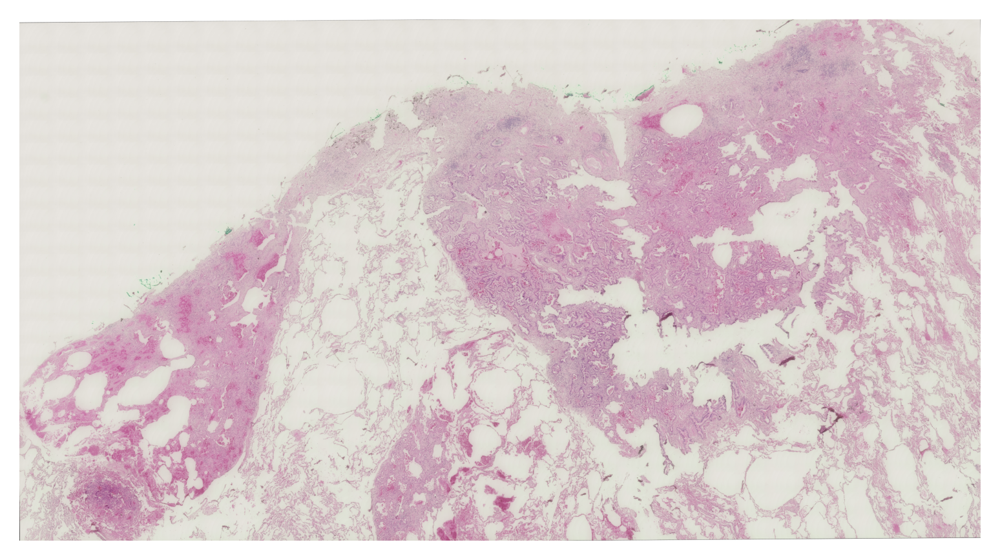

In [42]:
thumbnail = reader.slide_thumbnail(resolution=2, units="power")
plt.imshow(thumbnail)
plt.axis("off")
plt.show()

In [43]:
thumbnail .shape

(2353, 4332, 3)

## Semantic segmentation

In [44]:
from tiatoolbox import logger
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.models.engine.semantic_segmentor import (
    IOSegmentorConfig,
    SemanticSegmentor,
)
from tiatoolbox.utils.misc import download_data, imread

# We need this function to visualize the nuclear predictions
from tiatoolbox.utils.visualization import overlay_prediction_mask
from tiatoolbox.wsicore.wsireader import WSIReader

In [45]:
# Should be changed to False if no cuda-enabled GPU is available.
ON_GPU = True  # Default is True.

In [48]:
# Tile prediction
bcc_segmentor = SemanticSegmentor(
    pretrained_model="fcn_resnet50_unet-bcss",
    num_loader_workers=0,
    batch_size=4,
)

bcc_wsi_ioconfig = IOSegmentorConfig(
    input_resolutions=[{"units": "mpp", "resolution": 0.38}],
    output_resolutions=[{"units": "mpp", "resolution": 0.38}],
    patch_input_shape=[1024, 1024],
    patch_output_shape=[512, 512],
    stride_shape=[512, 512],
    save_resolution={"units": "mpp", "resolution": 2},
)

# WSI prediction
# if ON_GPU=False, this part will take more than a couple of hours to process.
wsi_output = bcc_segmentor.predict(
    [file_path],
    masks=None,
    save_dir="HE_wsi_semantic_results/",
    mode="wsi",
    on_gpu=ON_GPU,
    ioconfig=bcc_wsi_ioconfig,
    crash_on_exception=True,
)

Download from https://tiatoolbox.dcs.warwick.ac.uk/models/seg/fcn_resnet50_unet-bcss.pth
Save to C:\Users\thu71\.tiatoolbox\models/fcn_resnet50_unet-bcss.pth


Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
Metadata: Objective power inferred from microns-per-pixel (MPP).
Process Batch:   0%|                                    | 0/978 [00:00<?, ?it/s]Metadata: Falling back to TIFF resolution tag for microns-per-pixel (MPP).
Metadata: Objective power inferred from microns-per-pixel (MPP).
Process Batch: 100%|##########################| 978/978 [26:48<00:00,  1.64s/it]
INFO:root:Finish: 0
INFO:root:--Input: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_20X.ome.tif
INFO:root:--Output: y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_semantic_results\0


In [49]:
wsi_output

[['Y:\\coskun-lab\\Thomas\\23_PLA_revision\\data\\tissue\\HE_reg_pyr\\577-1197_20X.ome.tif',
  'y:\\coskun-lab\\Thomas\\23_PLA_revision\\notebooks\\HE_wsi_semantic_results\\0']]

INFO:root:Prediction method output is: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_20X.ome.tif, y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_semantic_results\0
INFO:root:Raw prediction dimensions: (4441, 8176, 5)
INFO:root:Processed prediction dimensions: (4441, 8176)
INFO:root:WSI original dimensions: (43325, 23530)
INFO:root:WSI overview dimensions: (4441, 8176)


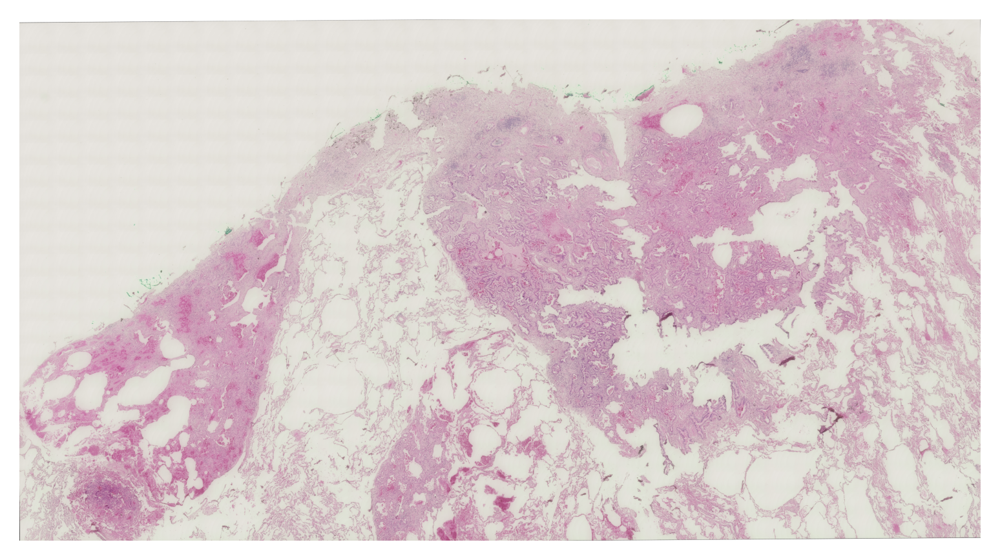

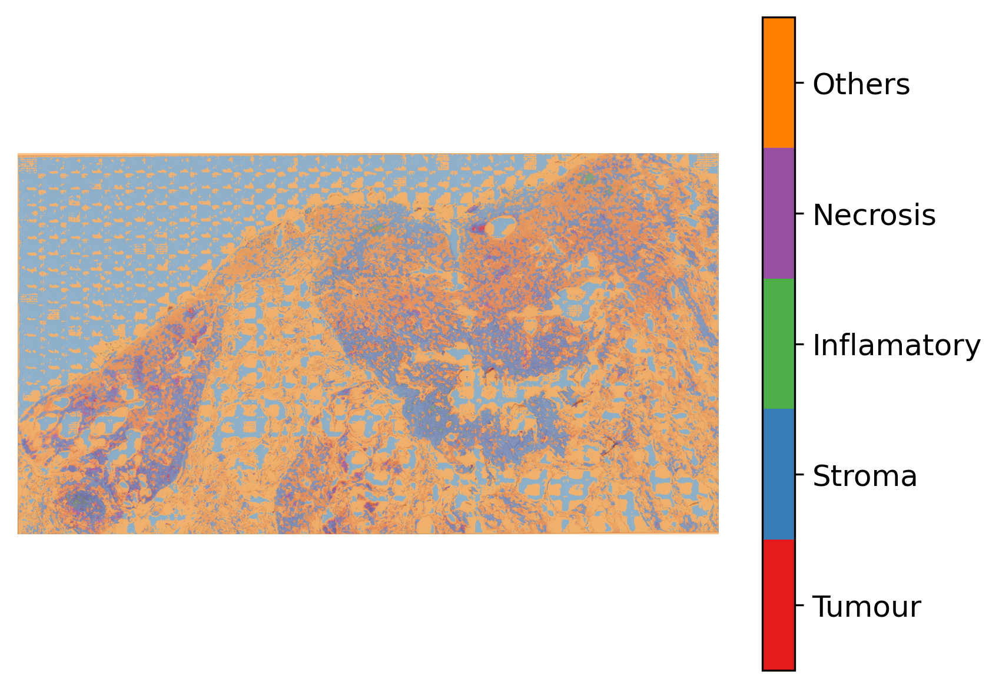

In [50]:
logger.info(
    "Prediction method output is: %s, %s",
    wsi_output[0][0],
    wsi_output[0][1],
)
wsi_prediction_raw = np.load(
    wsi_output[0][1] + ".raw.0.npy",
)  # Loading the first prediction [0] based on the output address [1]
logger.info(
    "Raw prediction dimensions: (%d, %d, %d)",
    wsi_prediction_raw.shape[0],
    wsi_prediction_raw.shape[1],
    wsi_prediction_raw.shape[2],
)

# Simple processing of the raw prediction to generate semantic segmentation task
wsi_prediction = np.argmax(
    wsi_prediction_raw,
    axis=-1,
)  # select the class with highest probability
logger.info(
    "Processed prediction dimensions: (%d, %d)",
    wsi_prediction.shape[0],
    wsi_prediction.shape[1],
)

# [WSI overview extraction]
# Now reading the WSI to extract it's overview
wsi = WSIReader.open(file_path)
logger.info(
    "WSI original dimensions: (%d, %d)",
    wsi.info.slide_dimensions[0],
    wsi.info.slide_dimensions[1],
)

# using the prediction save_resolution to create the wsi overview at the same resolution
overview_info = bcc_wsi_ioconfig.save_resolution

# extracting slide overview using `slide_thumbnail` method
wsi_overview = wsi.slide_thumbnail(
    resolution=overview_info["resolution"],
    units=overview_info["units"],
)
logger.info(
    "WSI overview dimensions: (%d, %d)",
    wsi_overview.shape[0],
    wsi_overview.shape[1],
)
plt.figure(), plt.imshow(wsi_overview)
plt.axis("off")

# [Overlay map creation]
# creating label-color dictionary to be fed into `overlay_prediction_mask` function
# to help generating color legend
label_dict = {"Tumour": 0, "Stroma": 1, "Inflamatory": 2, "Necrosis": 3, "Others": 4}
label_color_dict = {}
colors = cm.get_cmap("Set1").colors
for class_name, label in label_dict.items():
    label_color_dict[label] = (class_name, 255 * np.array(colors[label]))
# Creat overlay map using the `overlay_prediction_mask` helper function
overlay = overlay_prediction_mask(
    wsi_overview,
    wsi_prediction,
    alpha=0.5,
    label_info=label_color_dict,
    return_ax=True,
)

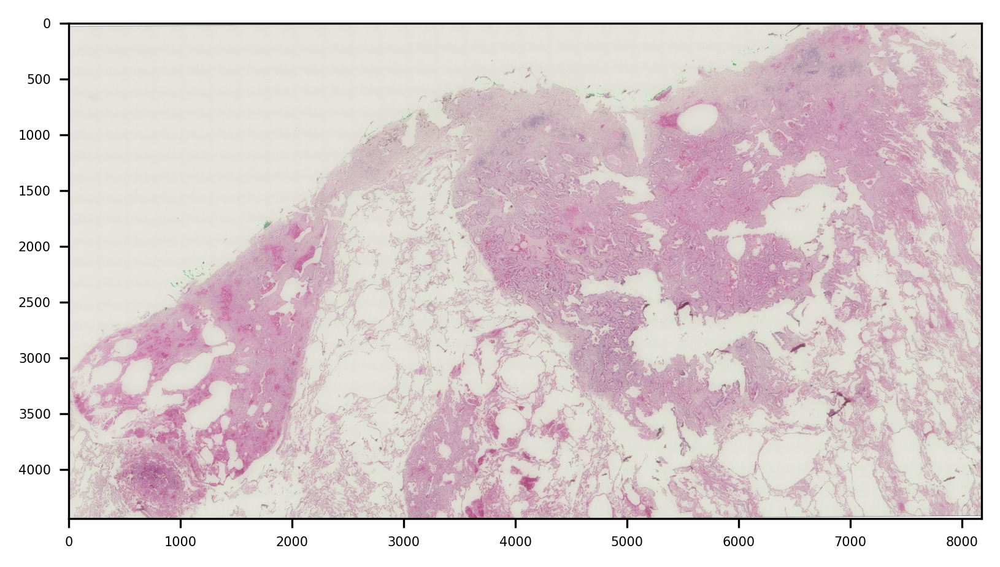

In [51]:
plt.imshow(wsi_overview)

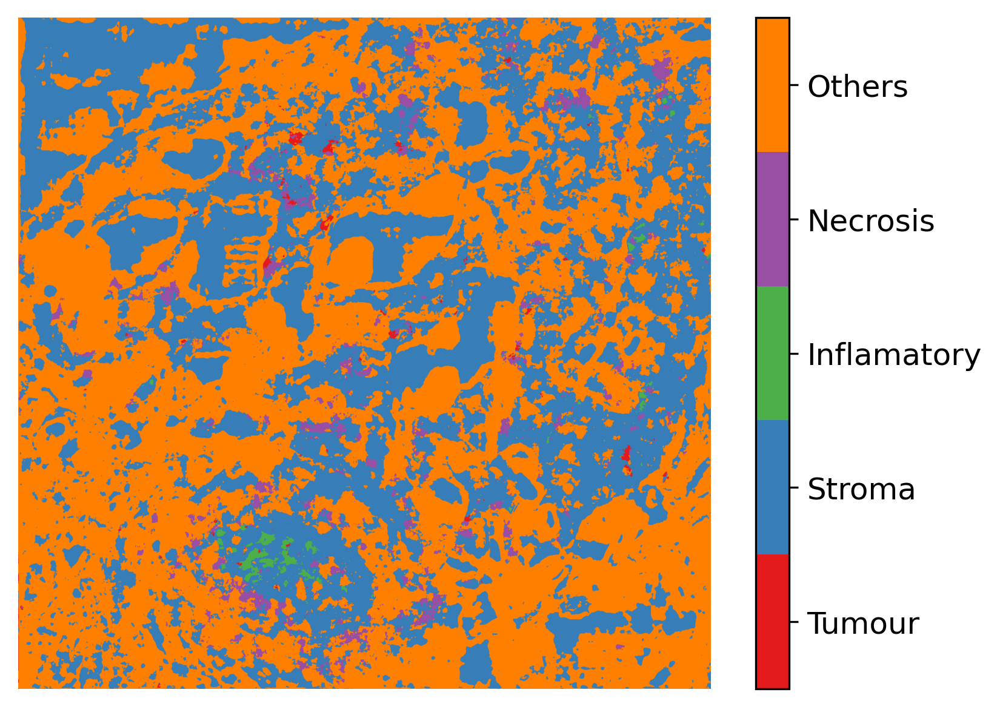

In [62]:
# Creat overlay map using the `overlay_prediction_mask` helper function
overlay = overlay_prediction_mask(
    wsi_overview[2500:, :2000],
    wsi_prediction[2500:, :2000],
    alpha=1,
    label_info=label_color_dict,
    return_ax=True,
)

# LOOP

In [20]:
file_paths = [r'Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_40X.ome.tif',
              r'Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1210_40X.ome.tif',]


In [21]:
from tiatoolbox import logger
from tiatoolbox.models.engine.nucleus_instance_segmentor import NucleusInstanceSegmentor
from tiatoolbox.utils.misc import download_data, imread

# We need this function to visualize the nuclear predictions
from tiatoolbox.utils.visualization import (
    overlay_prediction_contours,
)
from tiatoolbox.wsicore.wsireader import WSIReader

In [75]:
# Should be changed to False if no cuda-enabled GPU is available.
ON_GPU = True  # Default is True.

In [76]:
# Instantiate the nucleus instance segmentor
inst_segmentor = NucleusInstanceSegmentor(
    pretrained_model="hovernet_fast-pannuke",
    num_loader_workers=0,
    num_postproc_workers=0,
    batch_size=8,
    auto_generate_mask=False,
    verbose=False,
)

# WSI prediction
# if ON_GPU=False, this part will take more than a couple of hours to process.
wsi_output = inst_segmentor.predict(
    file_paths,
    masks=None,
    save_dir="HE_wsi_results/",
    mode="wsi",
    on_gpu=ON_GPU,
    crash_on_exception=True,
)

Download from https://tiatoolbox.dcs.warwick.ac.uk/models/seg/hovernet_fast-pannuke.pth
Save to C:\Users\thu71\.tiatoolbox\models/hovernet_fast-pannuke.pth


Process Batch: 100%|##############################| 2/2 [00:01<00:00,  1.67it/s]
INFO:root:Finish: 0
INFO:root:--Input: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1197_40X.ome.tif
INFO:root:--Output: y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_results\0
Process Batch: 100%|##############################| 2/2 [00:01<00:00,  1.69it/s]
INFO:root:Finish: 0
INFO:root:--Input: Y:\coskun-lab\Thomas\23_PLA_revision\data\tissue\HE_reg_pyr\577-1210_40X.ome.tif
INFO:root:--Output: y:\coskun-lab\Thomas\23_PLA_revision\notebooks\HE_wsi_results\1


In [78]:
wsi_output

[['Y:\\coskun-lab\\Thomas\\23_PLA_revision\\data\\tissue\\HE_reg_pyr\\577-1197_40X.ome.tif',
  'y:\\coskun-lab\\Thomas\\23_PLA_revision\\notebooks\\HE_wsi_results\\0'],
 ['Y:\\coskun-lab\\Thomas\\23_PLA_revision\\data\\tissue\\HE_reg_pyr\\577-1210_40X.ome.tif',
  'y:\\coskun-lab\\Thomas\\23_PLA_revision\\notebooks\\HE_wsi_results\\1']]

In [87]:
import pickle 
with open("wsi.pickle", "wb") as f:
    pickle.dump(wsi_output, f)

In [82]:
file_path = wsi_output[1][0]
wsi_pred = joblib.load(f"{wsi_output[1][1]}.dat")
logger.info("Number of detected nuclei: %d", len(wsi_pred))

# Extracting the nucleus IDs and select a random nucleus
rng = np.random.default_rng()
nuc_id_list = list(wsi_pred.keys())
selected_nuc_id = nuc_id_list[
    rng.integers(0, len(wsi_pred))
]  # randomly select a nucleus
logger.info("Nucleus prediction structure for nucleus ID: %s", selected_nuc_id)
sample_nuc = wsi_pred[selected_nuc_id]
sample_nuc_keys = list(sample_nuc)
logger.info(
    "Keys in the output dictionary: [%s, %s, %s, %s, %s]",
    sample_nuc_keys[0],
    sample_nuc_keys[1],
    sample_nuc_keys[2],
    sample_nuc_keys[3],
    sample_nuc_keys[4],
)
logger.info(
    "Bounding box: (%d, %d, %d, %d)",
    sample_nuc["box"][0],
    sample_nuc["box"][1],
    sample_nuc["box"][2],
    sample_nuc["box"][3],
)
logger.info(
    "Centroid: (%d, %d)",
    sample_nuc["centroid"][0],
    sample_nuc["centroid"][1],
)

INFO:root:Number of detected nuclei: 6682
INFO:root:Nucleus prediction structure for nucleus ID: 009018b6d1c74d20ad6da0f260949f82
INFO:root:Keys in the output dictionary: [box, centroid, contour, prob, type]
INFO:root:Bounding box: (6142, 3680, 6163, 3699)
INFO:root:Centroid: (6152, 3688)


INFO:root:WSI original dimensions: (8522, 5560)


INFO:root:WSI overview dimensions: (4197, 6433, 3)


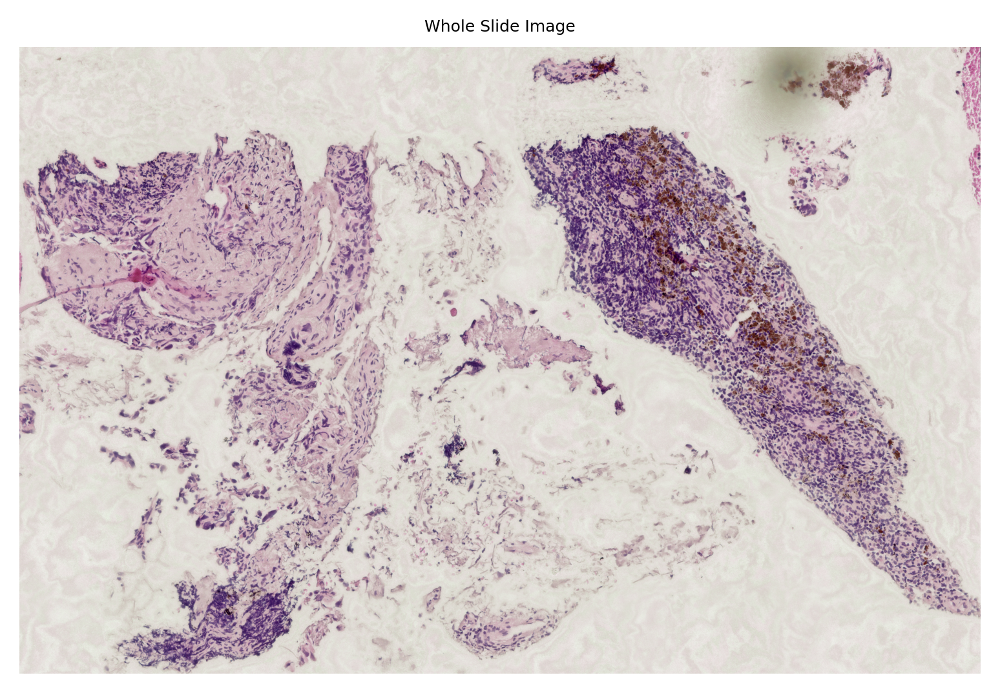

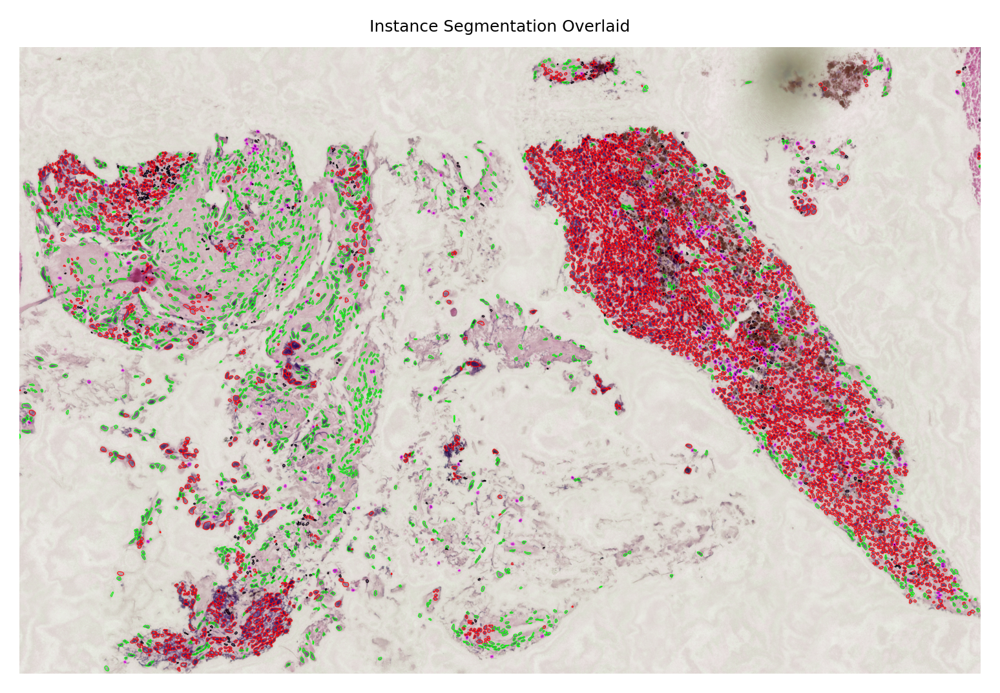

In [83]:
# [WSI overview extraction]
# Reading the WSI
wsi = WSIReader.open(file_path)
logger.info(
    "WSI original dimensions: (%d, %d)",
    wsi.info.slide_dimensions[0],
    wsi.info.slide_dimensions[1],
)

# Reading the whole slide in the highest resolution as a plane image
wsi_overview = wsi.slide_thumbnail(resolution=0.25, units="mpp")
logger.info(
    "WSI overview dimensions: (%d, %d, %d)",
    wsi_overview.shape[0],
    wsi_overview.shape[1],
    wsi_overview.shape[2],
)

# color_dict = {
#     0: ("nolabel", (0, 0, 0)),
#     1: ("epithelial", (255, 0, 0)),
#     2: ("lymphocyte", (0, 255, 0)),
#     3: ("macrophage", (0, 0, 255)),
#     4: ("neutrophil",(255, 255, 0)),
# }
color_dict = {
    0: ("neoplastic epithelial", (255, 0, 0)),
    1: ("Inflammatory", (255,0,255)),
    2: ("Connective", (0, 255, 0)),
    3: ("Dead", (0, 0, 0)),
    4: ("non-neoplastic epithelial", (255, 0, 0)),
}

# Create the overlay image
overlaid_predictions = overlay_prediction_contours(
    canvas=wsi_overview,
    inst_dict=wsi_pred,
    draw_dot=False,
    type_colours=color_dict,
    line_thickness=4,
)

# showing processed results alongside the original images
fig = (
    plt.figure(),
    plt.imshow(wsi_overview),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)

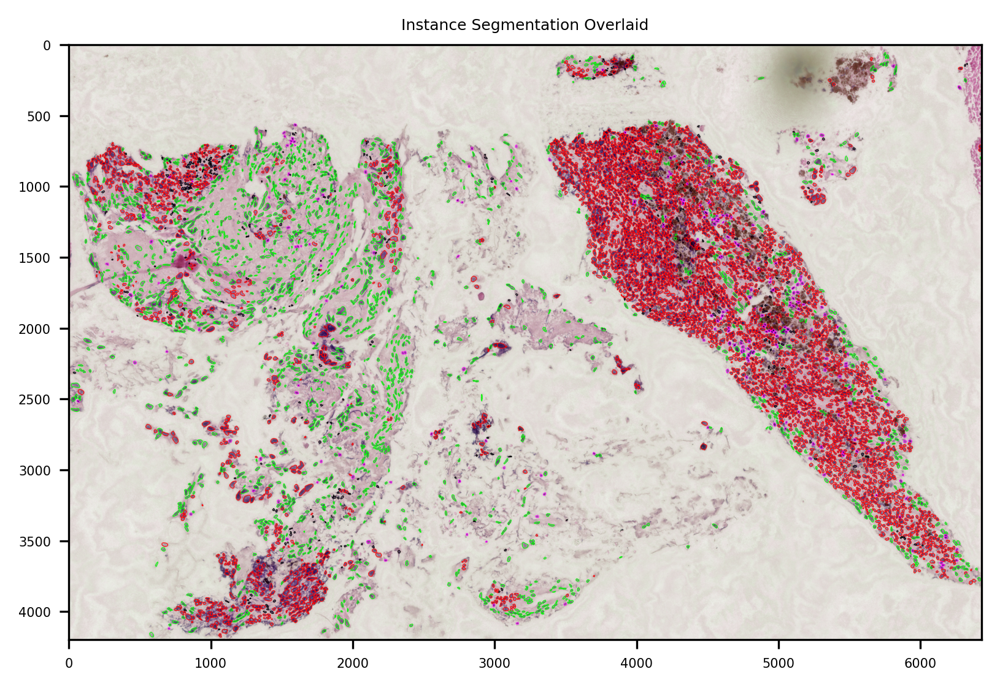

In [84]:
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions),
    plt.title("Instance Segmentation Overlaid"),
)

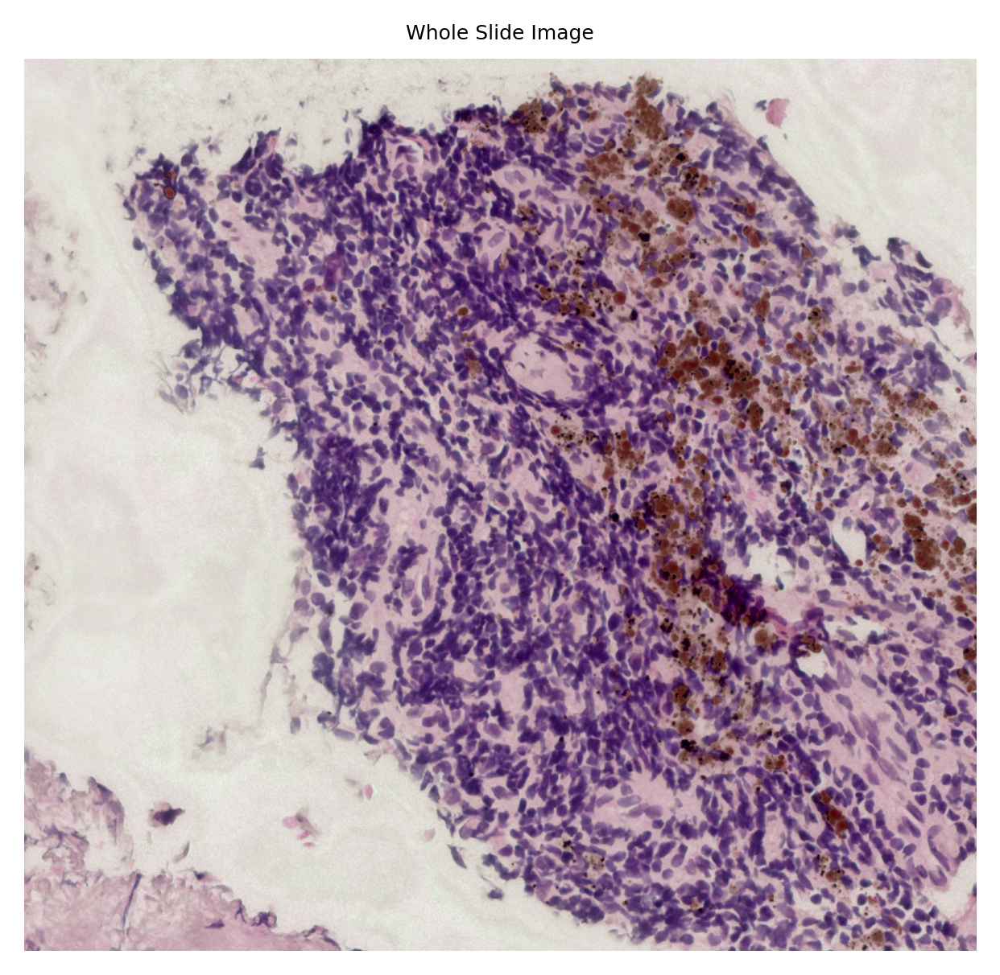

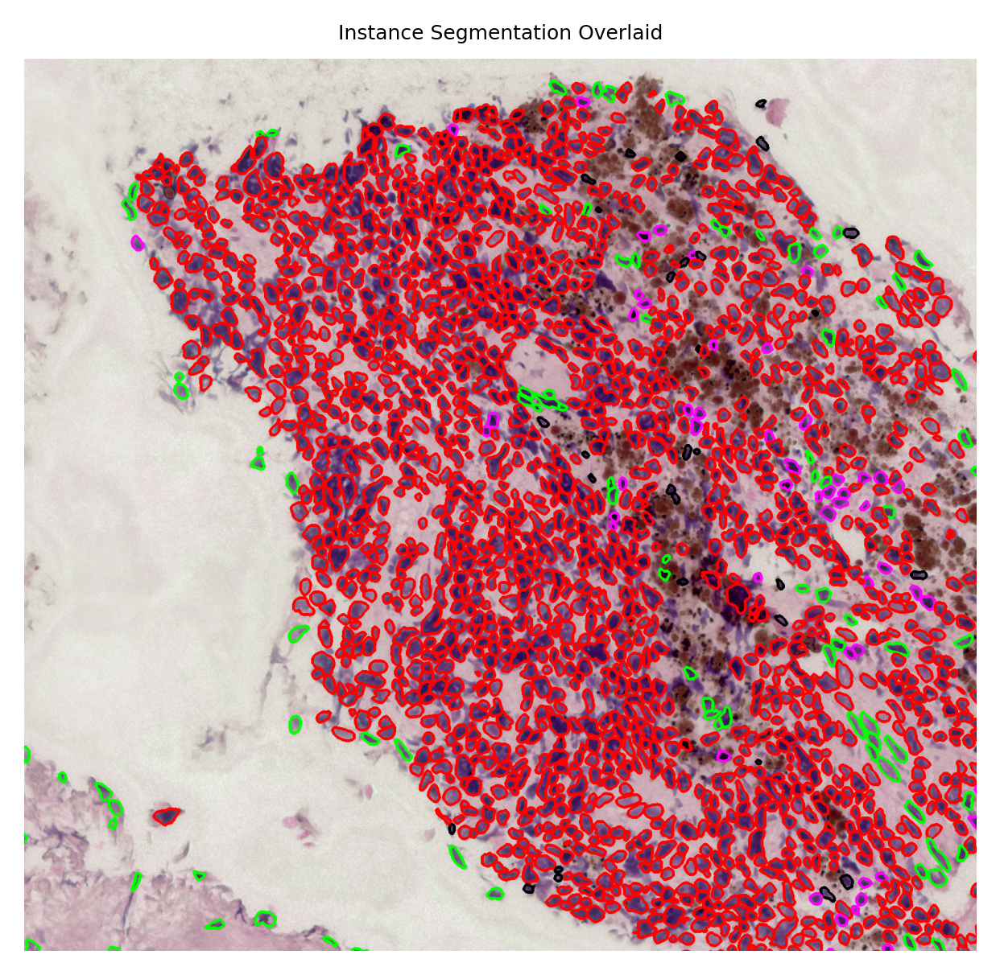

In [85]:
y_min, y_max = 500, 2000
x_min, x_max = 3200, 4800
fig = (
    plt.figure(),
    plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)

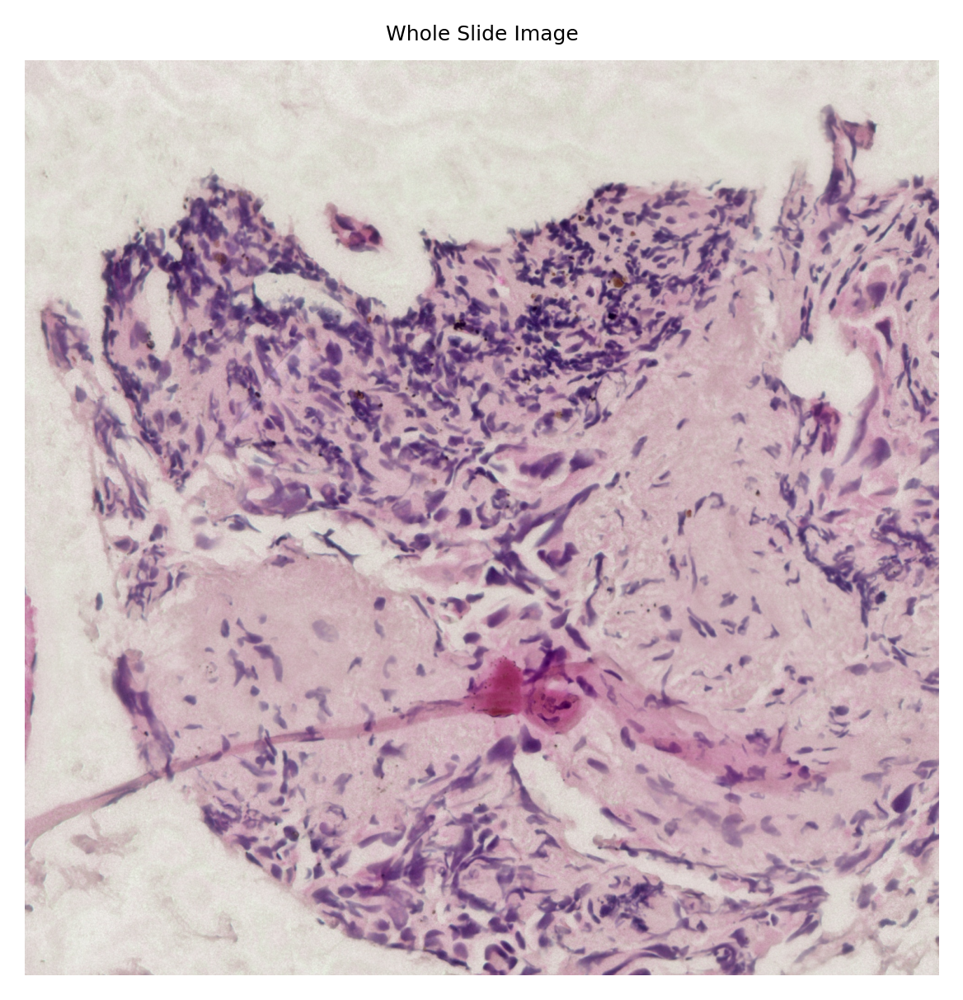

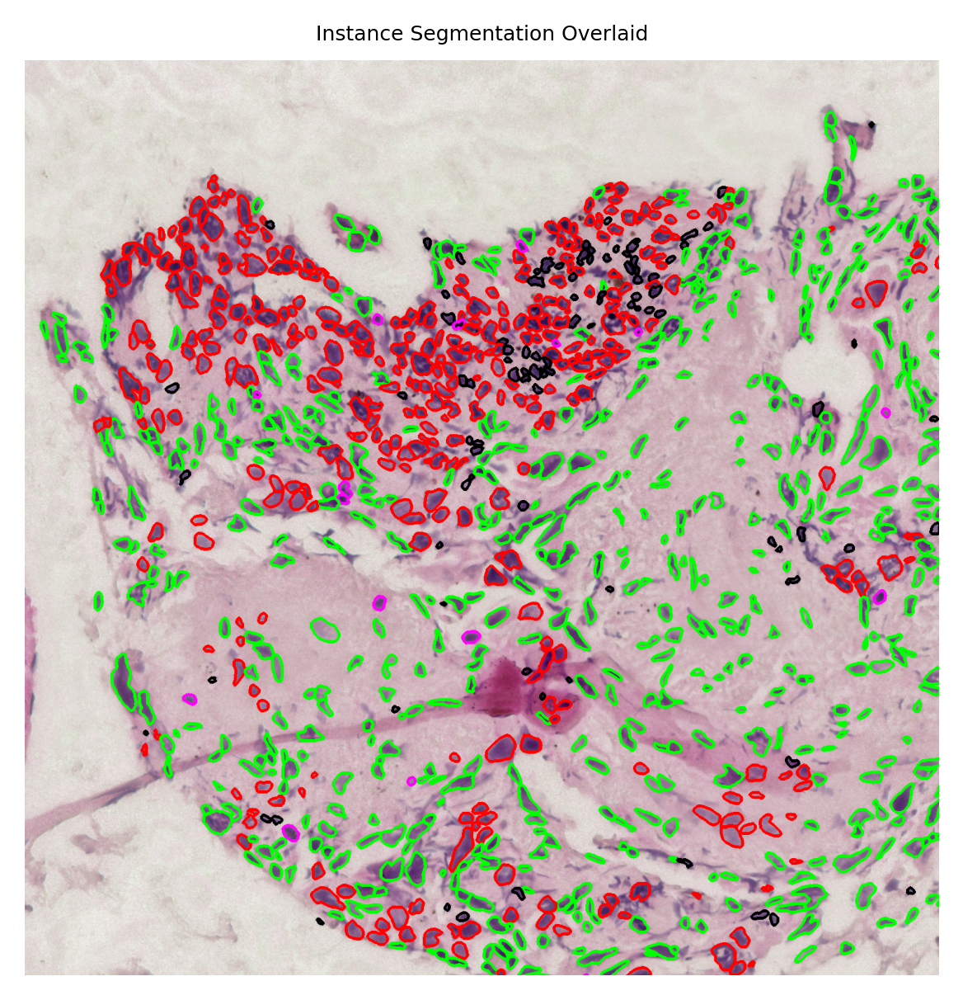

In [86]:
y_min, y_max = 500, 2000
x_min, x_max = 0, 1500
fig = (
    plt.figure(),
    plt.imshow(wsi_overview[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Whole Slide Image"),
)
fig = (
    plt.figure(),
    plt.imshow(overlaid_predictions[y_min:y_max, x_min:x_max]),
    plt.axis("off"),
    plt.title("Instance Segmentation Overlaid"),
)